## Intensity Transformation

In [21]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

In [22]:
# Load the image
image = cv2.imread('fractured_spine.tif')
image_2 = cv2.imread('Formula1.jpeg')
image_3 = cv2.imread('kidney.tif')
image_4 = cv2.imread('dollar.tif')

In [23]:
def colortobgr(img):
  # converting the image to grayscale so we can use it for fourier transform. crow
  img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  return img

In [34]:
img = colortobgr(image)
img_3 = colortobgr(image_3)
img_4 = colortobgr(image_4)

## Log Transformation
 Log transformations can be expressed as s = clog(1+r). Here, s is the output intensity, r>=0 is the input intensity of the pixel, and c is a scaling constant. c is given by 255/(log (1 + m)), where m is the maximum pixel value in the image.

<ipython-input-25-c32e32ad9236>:4: RuntimeWarning: divide by zero encountered in log
  log_transform = c * np.log(1 + image_2)


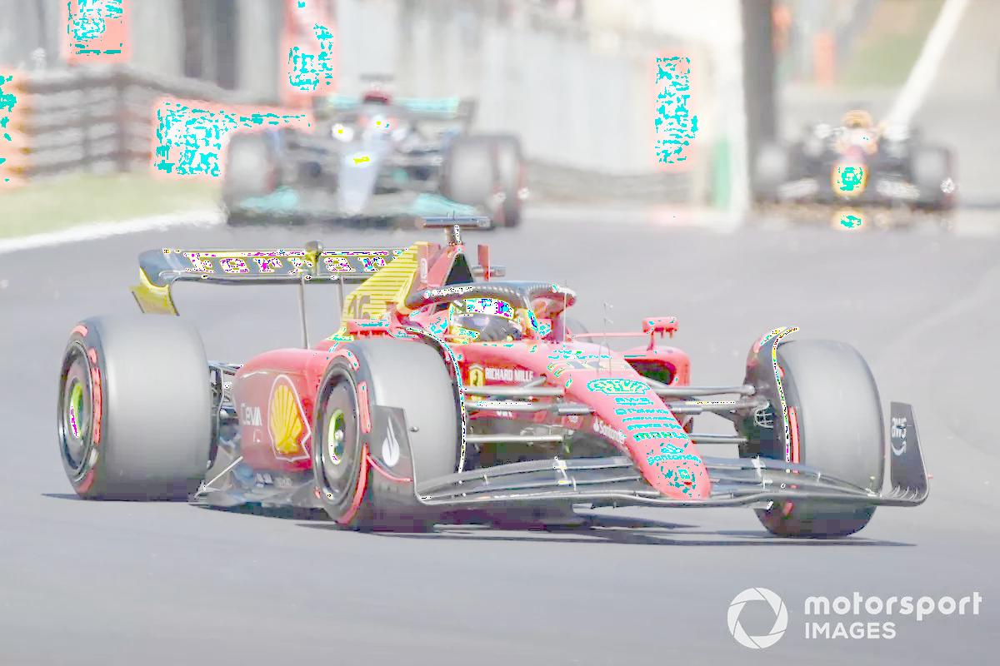

In [25]:
# Calculating constant
c = 255 / (np.log(1+np.max(image_2)))
# Calculating the log transform
log_transform = c * np.log(1 + image_2)

# Specify the data type.
log_transformed_image = np.array(log_transform, dtype = np.uint8)
# Result
cv2_imshow(log_transformed_image)

## Power Law (Gamma) Transformation
Power-law (gamma) transformations can be mathematically expressed as S = c*r^(gamma)


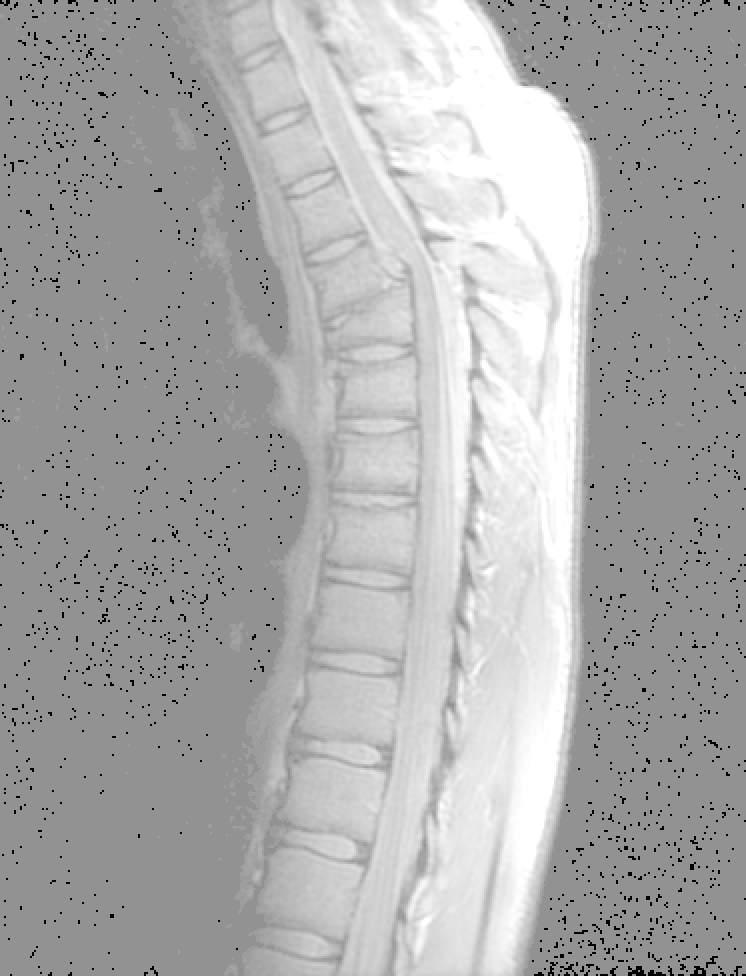

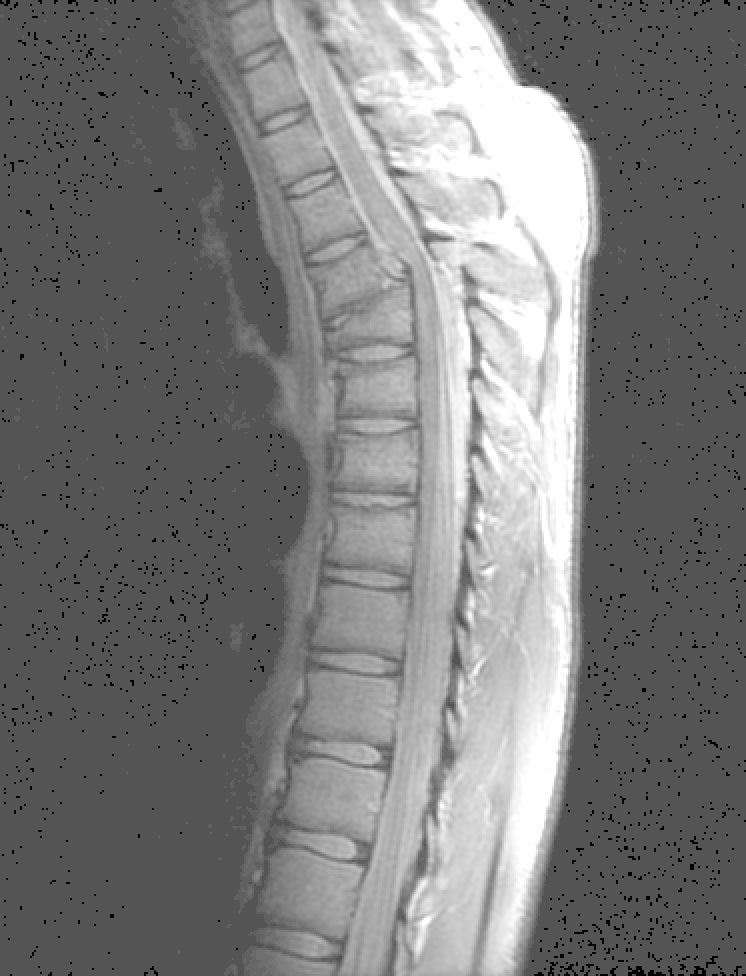

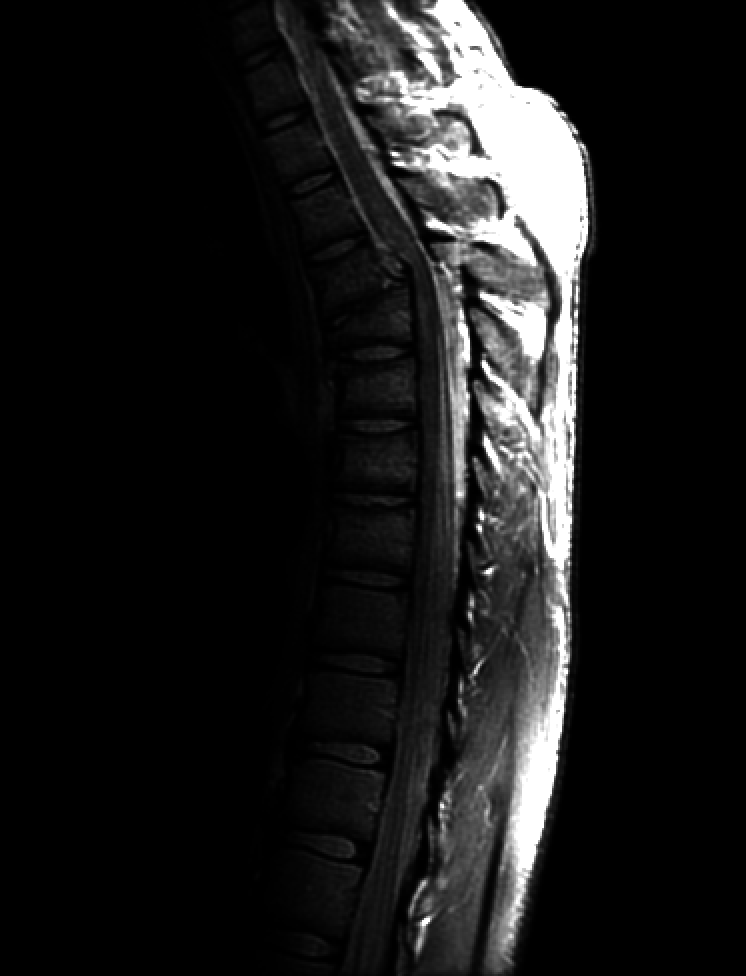

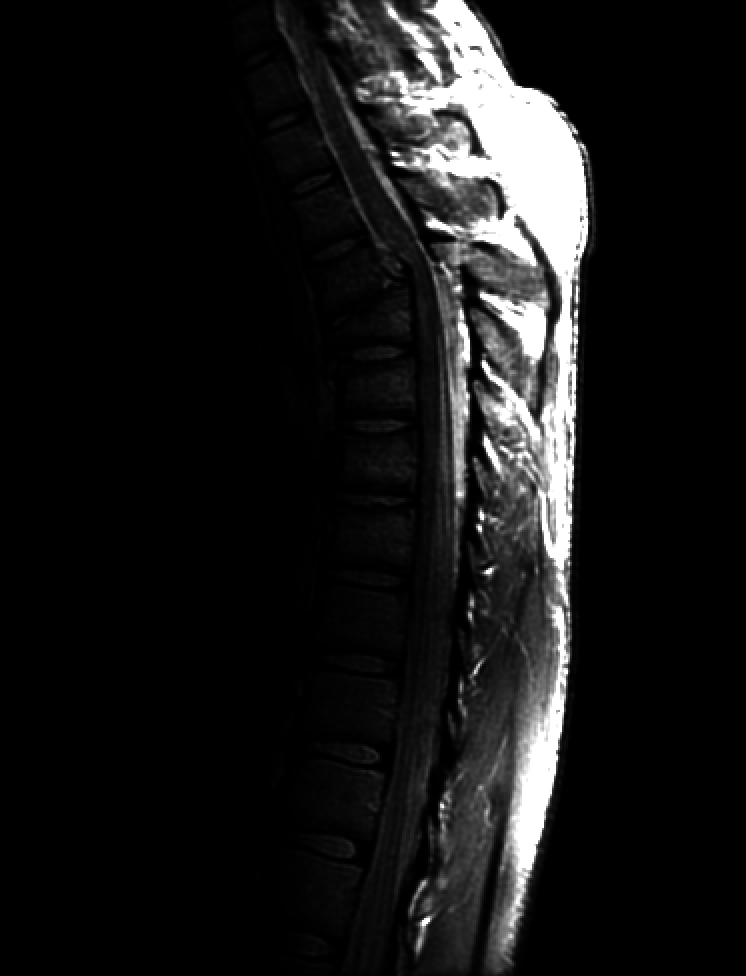

In [26]:
# Trying different values of gamma
gamma = [0.1, 0.2, 1.3, 1.6]
for g in gamma:
  # Calculating the new image
  gamma_corrected = np.array(255*(img / 255) ** g, dtype = 'uint8')
  # Displaying each image
  cv2_imshow(gamma_corrected)


## Piecewise Linear Transformation Function
These functions, as the name suggests, are not entirely linear in nature. However, they are linear between certain x-intervals. One of the most commonly used piecewise-linear transformation functions is contrast stretching.



In [27]:
def pixel_value(pix, r1, s1, r2, s2):
  if (0<=pix and pix<=r1):
    return (s1/r1)*pix
  elif r1<=pix and r1<=r2:
    return ((s2 - s1)/(r2 - r1)) * (pix - r1) + s1
  else:
    return ((255 - s2)/(255 - r2)) * (pix - r2) + s2


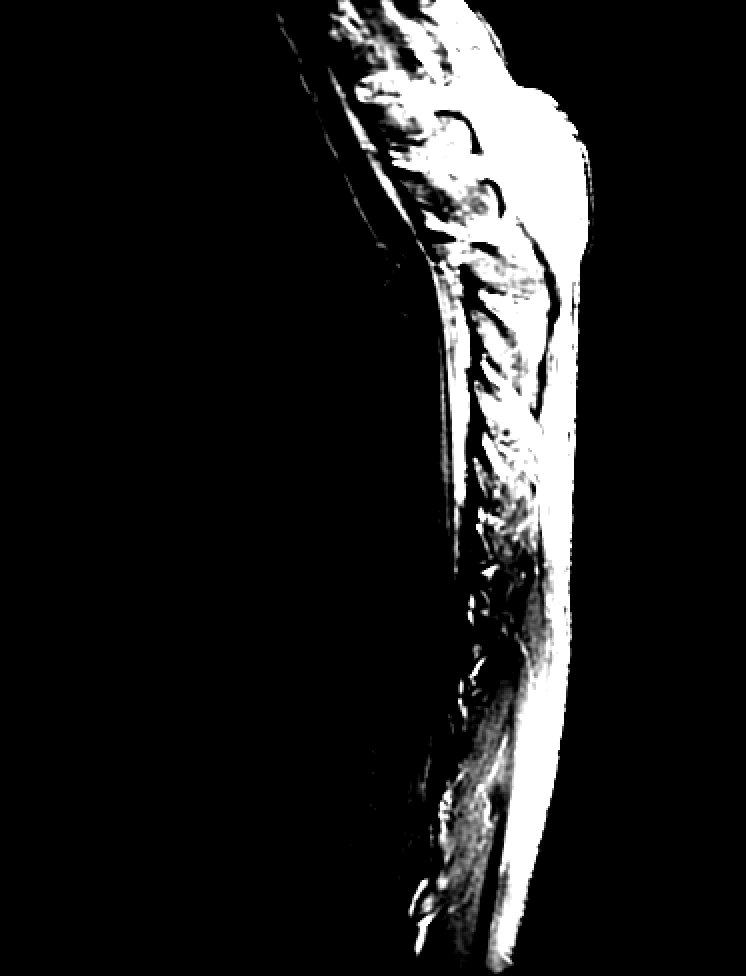

In [28]:
# Define parameters.
r1 = 70
s1 = 0
r2 = 140
s2 = 255

# Vectorize the function to apply it to each value in the Numpy array.
pixelVal_vec = np.vectorize(pixel_value)

# Apply contrast stretching.
contrast_stretched = pixelVal_vec(img, r1, s1, r2, s2)

# Result
cv2_imshow(contrast_stretched)


In [29]:
row, column = img_3.shape
# Create an zeros array to store the sliced image
new_img = np.zeros((row,column),dtype = 'uint8')
# Loop over the input image and if pixel value lies in desired range set it to 255 otherwise set it to 0.
# Specify the min range
min_range = 140
for i in range(row):
  for j in range(column):
    if img_3[i,j]>min_range:
      new_img[i,j] = 255
    else:
      new_img[i,j] = 0

In [30]:
# Loop over the input image and if pixel value lies in desired range set it to 255 otherwise set it to 0.# Create an zeros array to store the sliced image
new_img2 = np.zeros((row,column),dtype = 'uint8')
for a in range(row):
  for b in range(column):
    if img_3[a,b]<min_range:
      new_img2[a,b] = 0
    else:
      new_img2[a,b] = img_3[a,b]

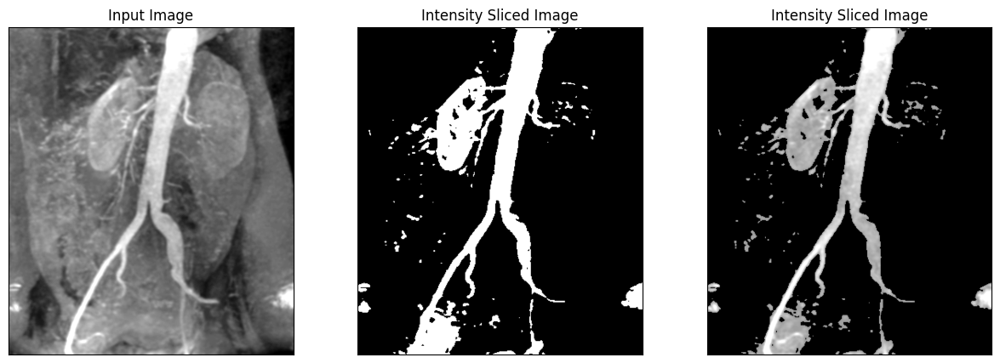

In [31]:
# Plotting the imput image and it's magnitude spectrum
plt.figure(figsize=(15,5))
plt.subplot(131),plt.imshow(img_3, cmap = 'gray')
plt.title('Input Image'), plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(new_img, cmap = 'gray')
plt.title('Intensity Sliced Image'), plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(new_img2, cmap = 'gray')
plt.title('Intensity Sliced Image'), plt.xticks([]), plt.yticks([])
plt.show()

## Bit Plane Slicing
Bit plane slicing is decomposing the image into multiple planes and converting each plane into binary bit by setting a threshold. These planes store imformation at different intensity levels and can be used for image compression.

(<Axes: >, <matplotlib.image.AxesImage at 0x7cb0de417460>)

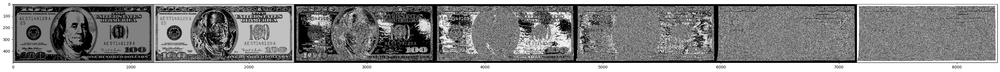

In [35]:
out = []
for k in range(7, 0, -1):
  # create an image for each k bit plane
  plane = np.full((img_4.shape[0], img_4.shape[1]), 2 ** (k), np.uint8)
  # execute bitwise and operation
  res = cv2.bitwise_and(plane, img_4)
  # multiply ones (bit plane sliced) with 255 just for better visualization
  x = res * 255
  # append to the output list
  out.append(x)
#cv2_imshow(np.hstack(out))
output_img = np.hstack(out)

# Plotting the imput image and it's magnitude spectrum
plt.figure(figsize=(100,50))
plt.subplot(122),plt.imshow(output_img, cmap = 'gray')

(<Axes: >, <matplotlib.image.AxesImage at 0x7cb0de347c10>)

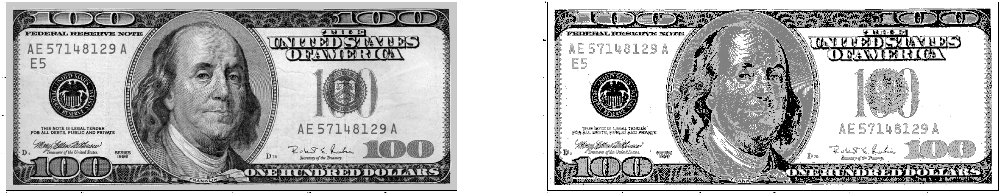

In [36]:
# Reconstructing the image using 2 bit planes (8 and 7)
reconstructed_img = cv2.add(out[0],out[1])

# Plotting the imput image and it's magnitude spectrum
plt.figure(figsize=(100,50))
plt.subplot(121),plt.imshow(img_4, cmap = 'gray')
plt.subplot(122),plt.imshow(reconstructed_img, cmap = 'gray')

(<Axes: >, <matplotlib.image.AxesImage at 0x7cb0dd6f6290>)

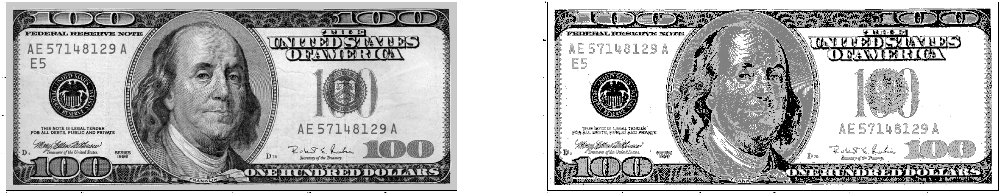

In [37]:
# Reconstructing the image using 4 bit planes (8,7,6,5)
reconstructed_img = cv2.add(out[0],out[1],out[2])
# Plotting the imput image and it's magnitude spectrum
plt.figure(figsize=(100,50))
plt.subplot(121),plt.imshow(img_4, cmap = 'gray')
plt.subplot(122),plt.imshow(reconstructed_img, cmap = 'gray')

(<Axes: >, <matplotlib.image.AxesImage at 0x7cb0f1768760>)

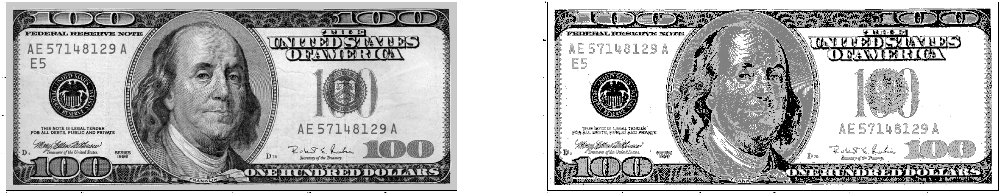

In [38]:
# Reconstructing the image using 4 bit planes (8,7,6,5)
reconstructed_img = cv2.add(out[0],out[1],out[2],out[3])
# Plotting the imput image and it's magnitude spectrum
plt.figure(figsize=(100,50))
plt.subplot(121),plt.imshow(img_4, cmap = 'gray')
plt.subplot(122),plt.imshow(reconstructed_img, cmap = 'gray')